In [1]:
import cv2

Trying on a random image

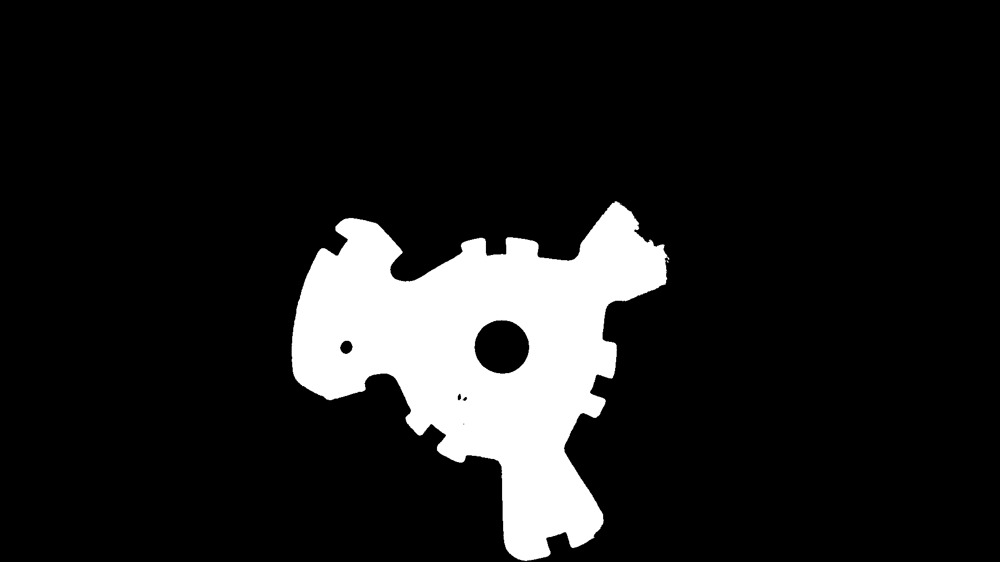

In [2]:
image = cv2.imread('/content/test/screenshot_2024-05-02_17-23-09.jpg')
# image to grayscale format
img_gray = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
# apply binary thresholding
from google.colab.patches import cv2_imshow
ret, thresh = cv2.threshold(img_gray, 180, 255, cv2.THRESH_BINARY)
cv2_imshow(thresh)
cv2.waitKey(0)
cv2.imwrite('image_thres1.jpg', thresh)
cv2.destroyAllWindows()


Using a template image

In [3]:
image = cv2.imread('/content/template/screenshot_2024-05-02_17-22-50.jpg')

In [4]:
# image to grayscale format
img_gray = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)

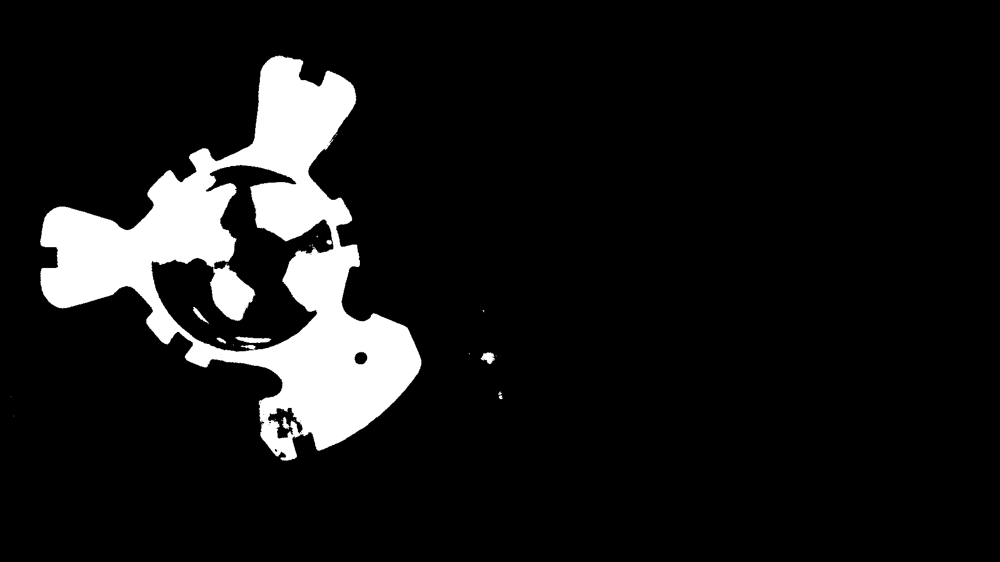

In [5]:
# apply binary thresholding
from google.colab.patches import cv2_imshow
ret, thresh = cv2.threshold(img_gray, 180, 255, cv2.THRESH_BINARY)
cv2_imshow(thresh)
cv2.waitKey(0)
cv2.imwrite('image_thres1.jpg', thresh)
cv2.destroyAllWindows()


Here the second parameter is for thresholding which is tunable

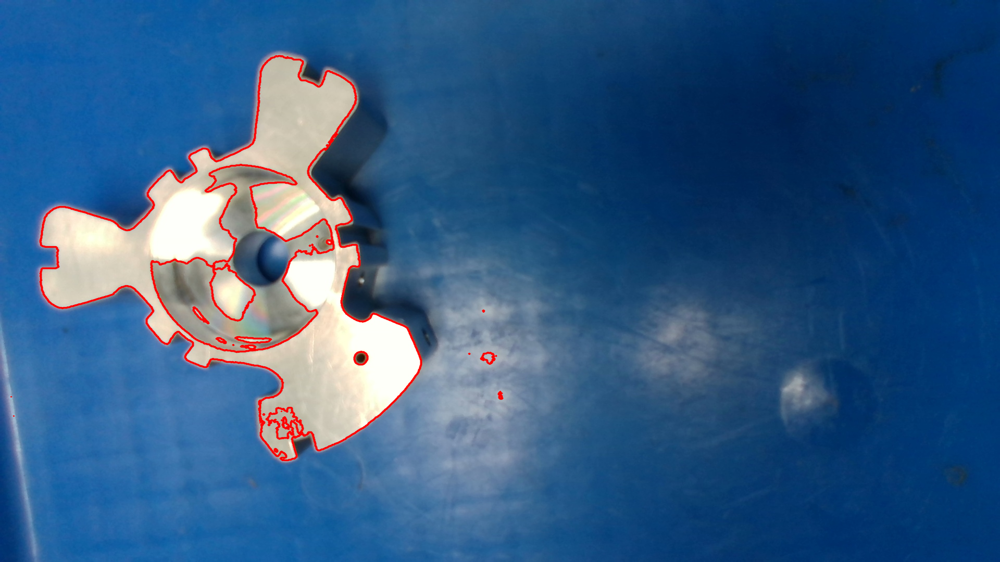

In [6]:

contours, hierarchy = cv2.findContours(image=thresh, mode=cv2.RETR_TREE, method=cv2.CHAIN_APPROX_NONE)

# draw contours on the original image
image_copy = image.copy()
cv2.drawContours(image=image_copy, contours=contours, contourIdx=-1, color=(0, 0, 255), thickness=2, lineType=cv2.LINE_AA)

cv2_imshow(image_copy)
cv2.waitKey(0)
cv2.imwrite('contours_none_image1.jpg', image_copy)
cv2.destroyAllWindows()

In [7]:
import numpy as np

There are too many contours , filtering on the size

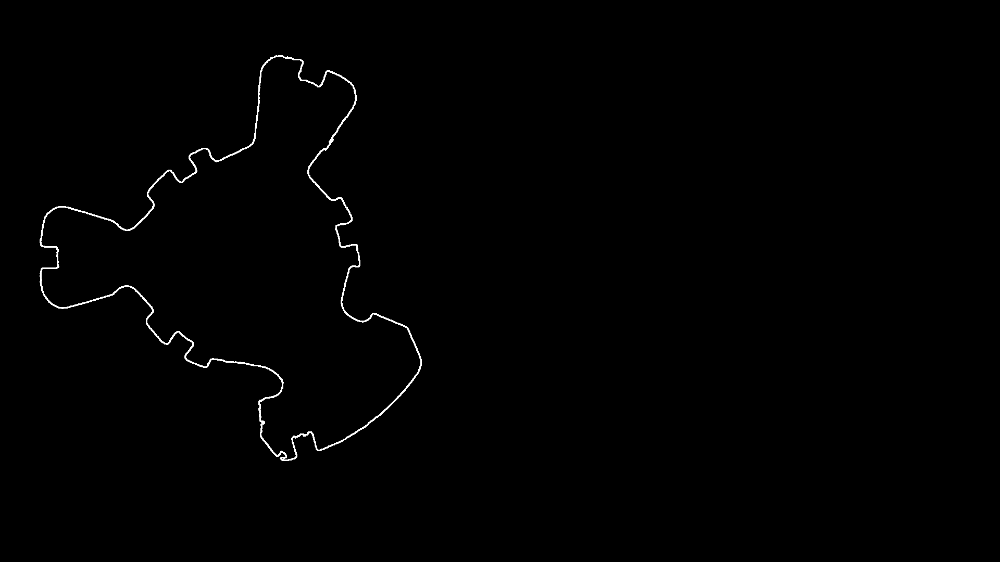

In [8]:

min_contour_area = 100000

# Create a blank image to draw contours
contour_image = np.zeros_like(image)

# Iterate over each contour and draw it on the blank image if its area is above the threshold
for i, contour in enumerate(contours):
    contour_area = cv2.contourArea(contour)
    if contour_area > min_contour_area:
        cv2.drawContours(contour_image, [contour], contourIdx=-1, color=(255, 255, 255), thickness=2)


        cv2_imshow(contour_image)
        cv2.waitKey(100)
        cv2.destroyAllWindows()
        contour_image = np.zeros_like(image)


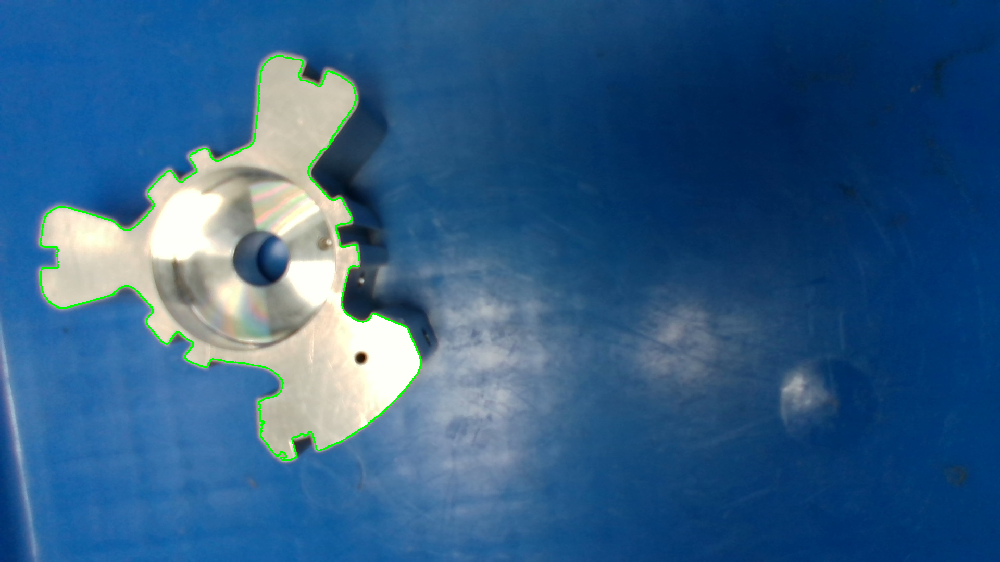

In [9]:
# Define a minimum contour area threshold
min_contour_area = 100000

# Iterate over each contour and draw it on the original image if its area is above the threshold
for i, contour in enumerate(contours):
    contour_area = cv2.contourArea(contour)
    if contour_area > min_contour_area:
        cv2.drawContours(image, [contour], contourIdx=-1, color=(0, 255, 0), thickness=2)


cv2_imshow(image)
cv2.waitKey(0)
cv2.destroyAllWindows()


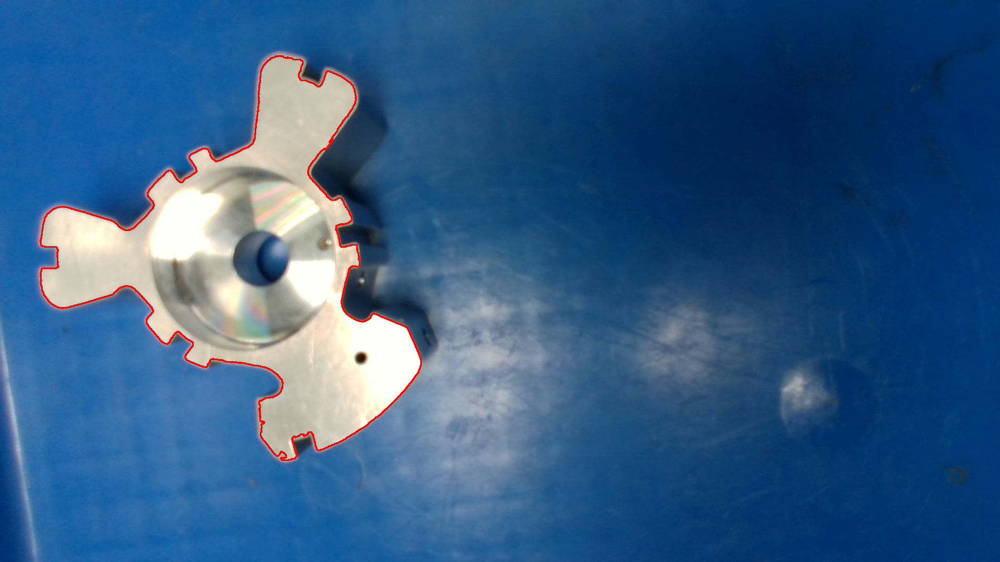

In [10]:
# Define a minimum contour area threshold
min_contour_area = 100000


contour_image = image.copy()

# Iterate over each contour and draw it on the copy of the original image if its area is above the threshold
for i, contour in enumerate(contours):
    contour_area = cv2.contourArea(contour)
    if contour_area > min_contour_area:
        cv2.drawContours(contour_image, [contour], contourIdx=-1, color=(0, 0, 255), thickness=2)


cv2_imshow(contour_image)
cv2.waitKey(0)
cv2.destroyAllWindows()


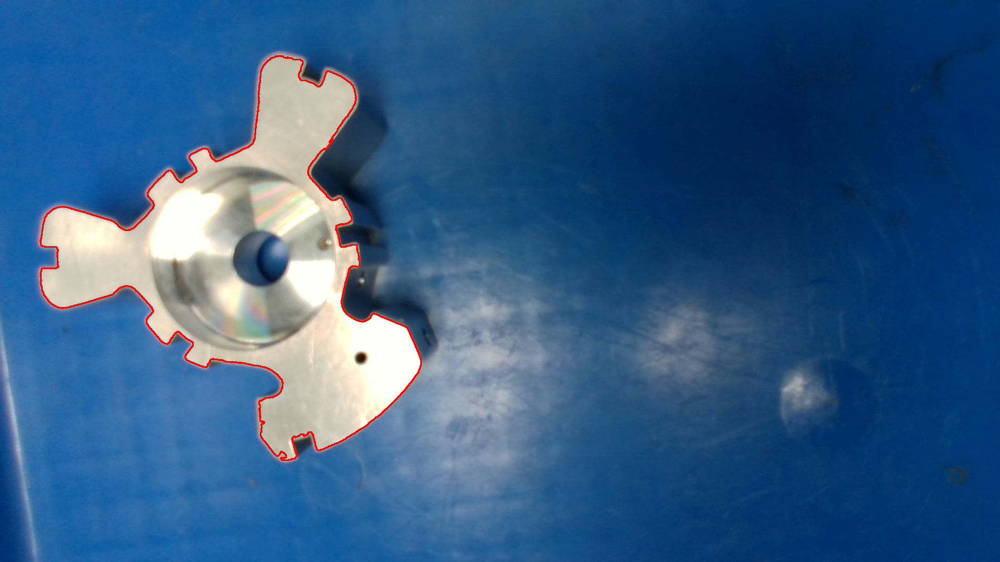

In [11]:
import cv2
from google.colab.patches import cv2_imshow
import numpy as np

# read the image
image = cv2.imread('/content/template/screenshot_2024-05-02_17-22-50.jpg')

# convert the image to grayscale format
img_gray = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)

# apply binary thresholding
ret, thresh = cv2.threshold(img_gray, 180, 255, cv2.THRESH_BINARY)

#tunable second parameter

# detect the contours on the binary image using cv2.CHAIN_APPROX_NONE
contours, hierarchy = cv2.findContours(image=thresh, mode=cv2.RETR_TREE, method=cv2.CHAIN_APPROX_NONE)

min_contour_area = 100000

# List to store contours that pass the area threshold
filtered_contours = []

# Iterate over each contour and store contours that pass the area threshold
for contour in contours:
    contour_area = cv2.contourArea(contour)
    if contour_area > min_contour_area:
        filtered_contours.append(contour)


contour_image = image.copy()
cv2.drawContours(contour_image, filtered_contours, contourIdx=0, color=(0, 0, 255), thickness=2)

cv2_imshow(contour_image)
cv2.waitKey(0)
cv2.destroyAllWindows()


ret, thresh = cv2.threshold(img_gray, 180, 255, cv2.THRESH_BINARY)

Here the second parameter is thresholding which controls the contour therefore we will change them see for contours

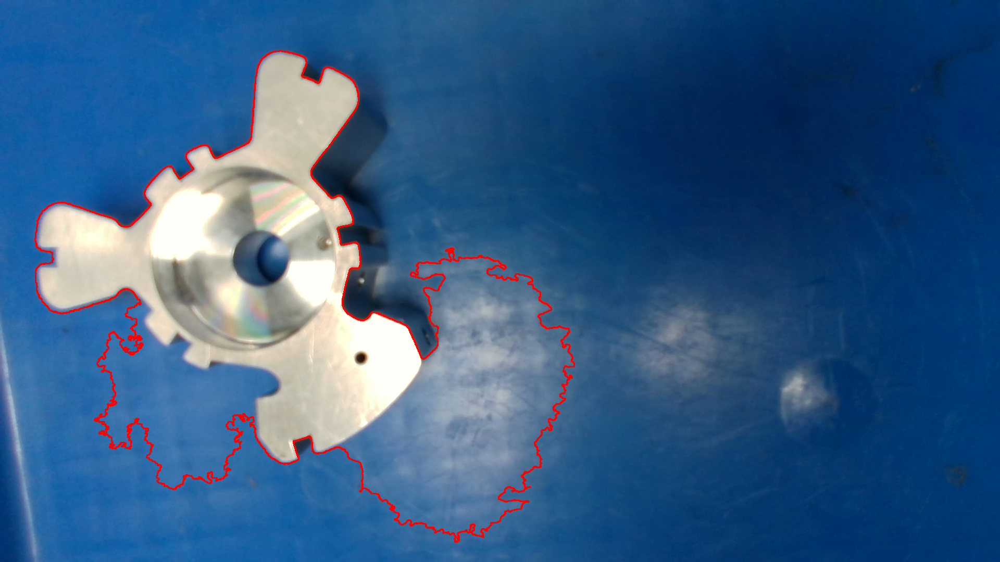

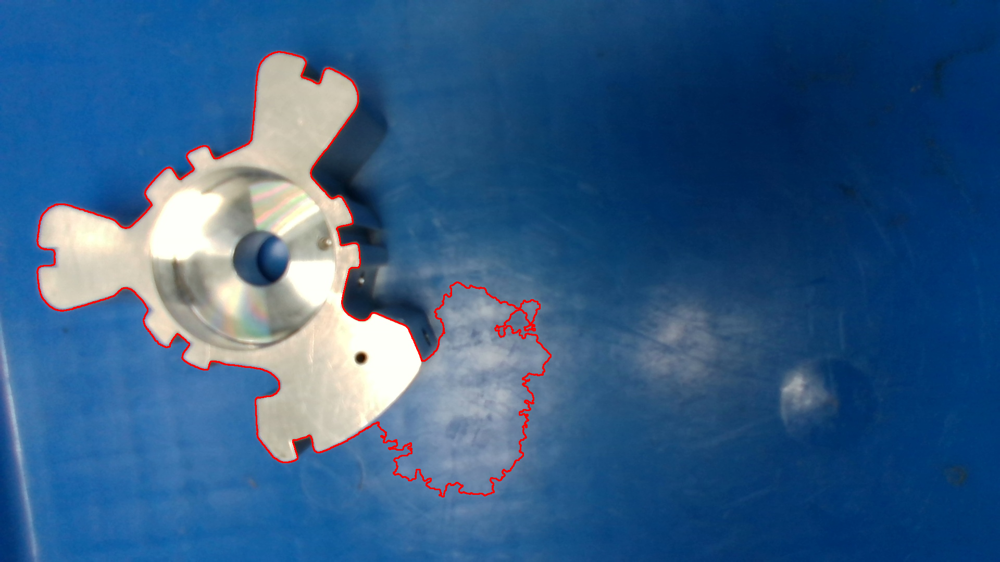

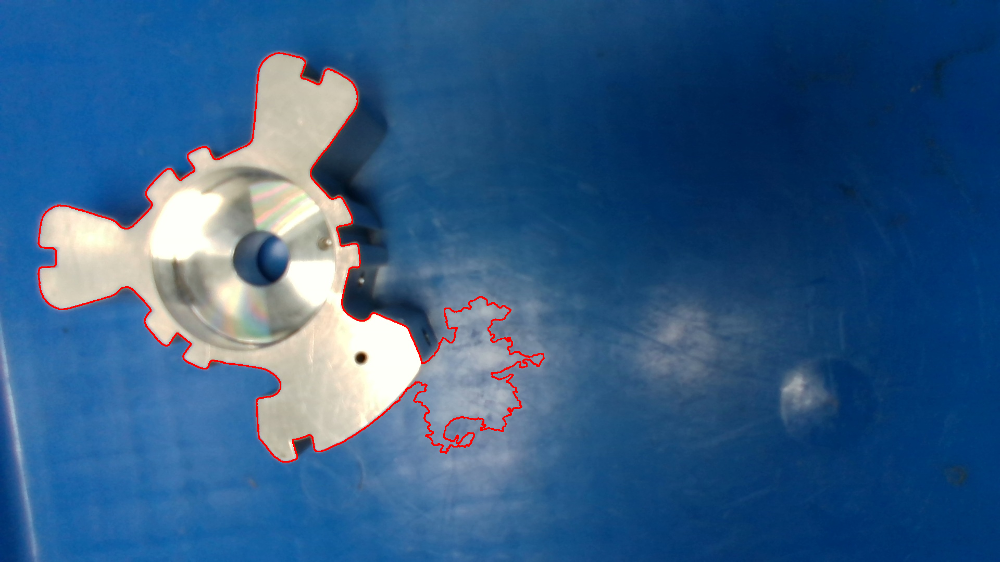

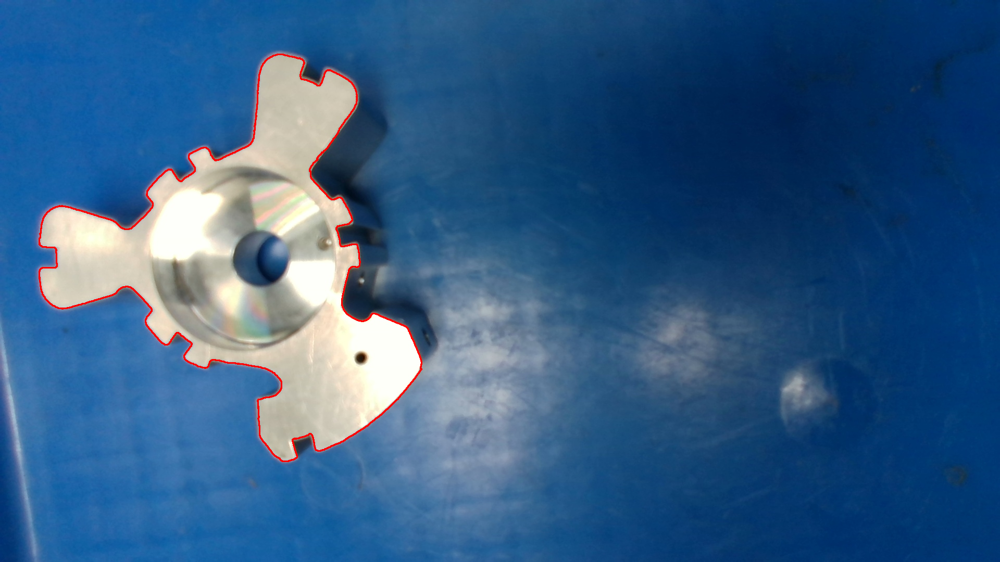

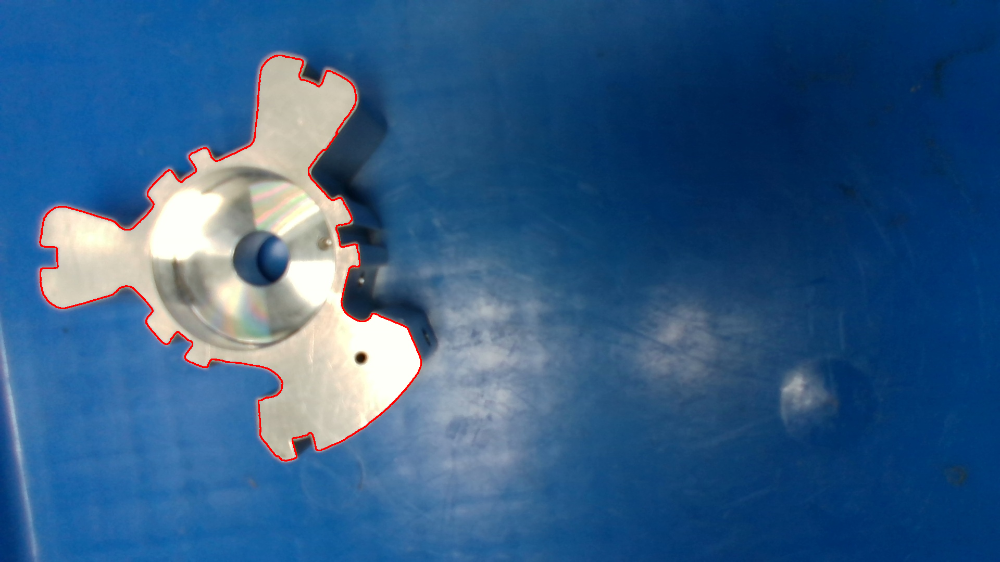

In [12]:
import cv2
from google.colab.patches import cv2_imshow
import numpy as np

# read the image
image = cv2.imread('/content/template/screenshot_2024-05-02_17-22-50.jpg')

# convert the image to grayscale format
img_gray = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)

# Define a list of threshold values to try
threshold_values = [100, 120, 140, 160, 175]

for threshold_value in threshold_values:
    # apply binary thresholding
    ret, thresh = cv2.threshold(img_gray, threshold_value, 255, cv2.THRESH_BINARY)

    contours, hierarchy = cv2.findContours(image=thresh, mode=cv2.RETR_TREE, method=cv2.CHAIN_APPROX_NONE)


    min_contour_area = 100000

    # List to store contours that pass the area threshold
    filtered_contours = []

    # Iterate over each contour and store contours that pass the area threshold
    for contour in contours:
        contour_area = cv2.contourArea(contour)
        if contour_area > min_contour_area:
            filtered_contours.append(contour)


    contour_image = image.copy()
    cv2.drawContours(contour_image, filtered_contours, contourIdx=0, color=(0, 0, 255), thickness=2)

    # Display the image with the selected contour drawn
    cv2_imshow(contour_image)
    cv2.waitKey(0)

cv2.destroyAllWindows()


160 gives the perfect contour


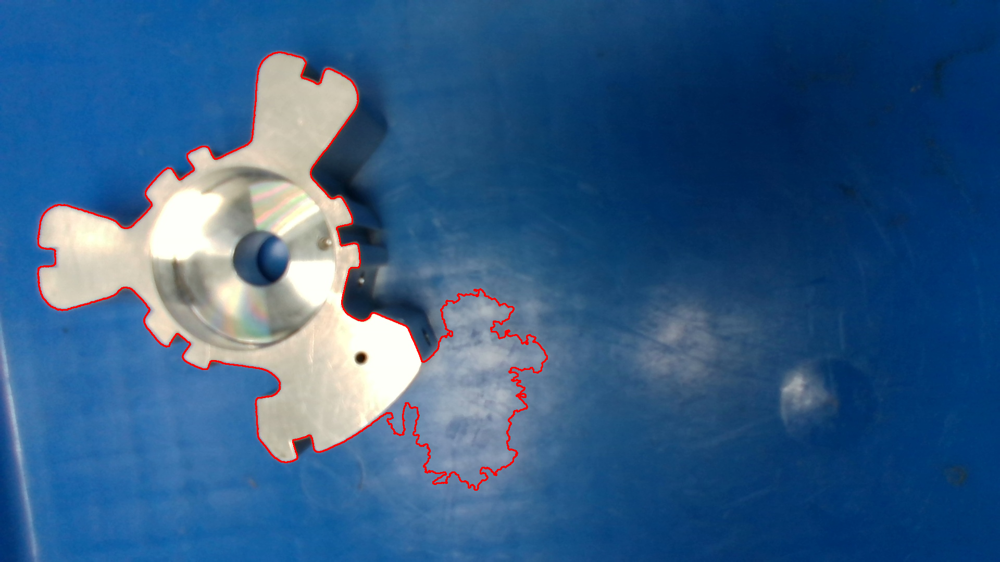

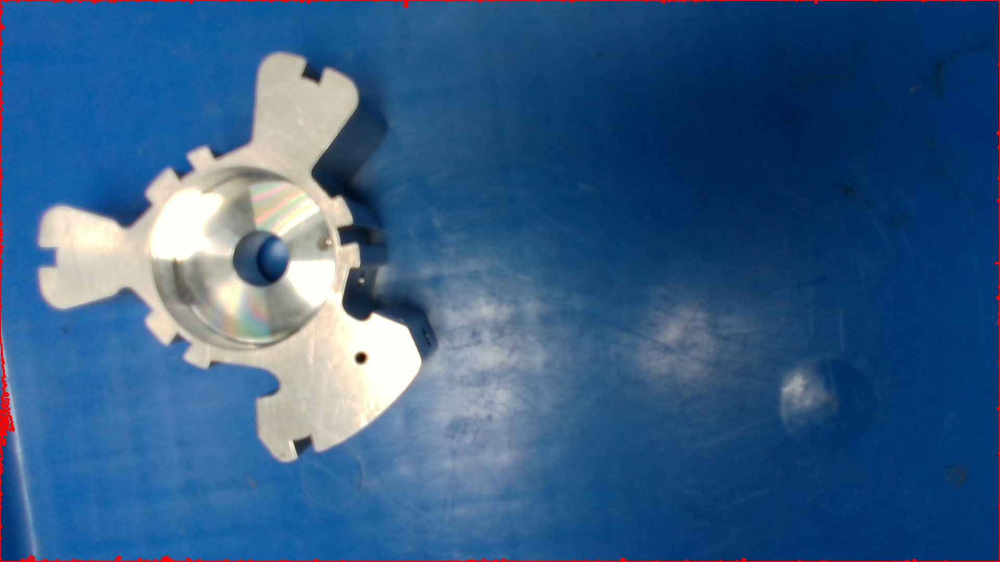

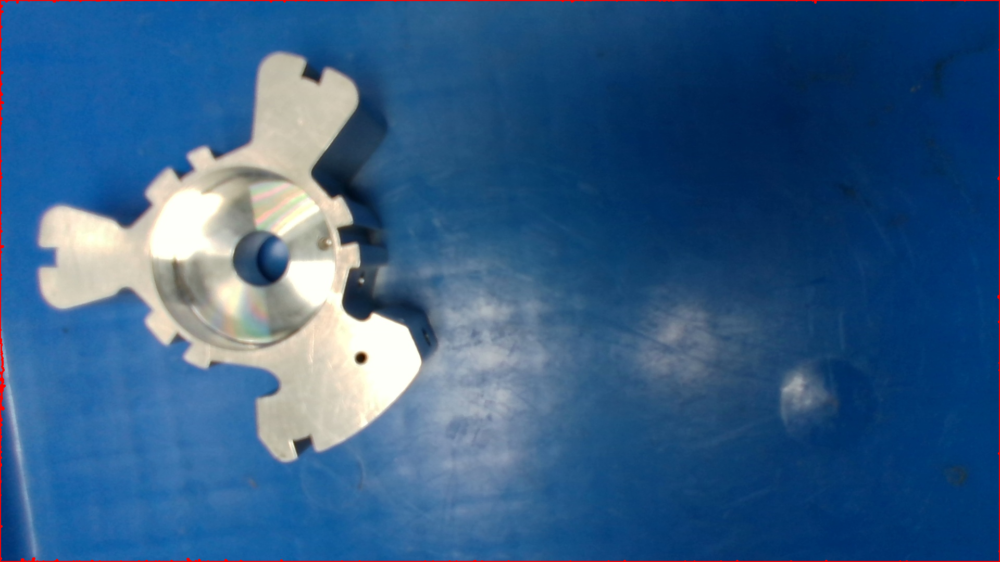

In [13]:
import cv2
from google.colab.patches import cv2_imshow

# Read the image
image = cv2.imread('/content/template/screenshot_2024-05-02_17-22-50.jpg')

# Convert the image to grayscale format
img_gray = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)

# Apply binary thresholding using Otsu's method
ret, thresh_otsu = cv2.threshold(img_gray, 0, 255, cv2.THRESH_BINARY + cv2.THRESH_OTSU)

# Apply adaptive thresholding with mean
thresh_mean = cv2.adaptiveThreshold(img_gray, 255, cv2.ADAPTIVE_THRESH_MEAN_C, cv2.THRESH_BINARY, 11, 2)

# Apply adaptive thresholding with Gaussian
thresh_gaussian = cv2.adaptiveThreshold(img_gray, 255, cv2.ADAPTIVE_THRESH_GAUSSIAN_C, cv2.THRESH_BINARY, 11, 2)

# Detect the contours on the binary image using cv2.CHAIN_APPROX_NONE for Otsu's method
contours_otsu, hierarchy_otsu = cv2.findContours(image=thresh_otsu, mode=cv2.RETR_TREE, method=cv2.CHAIN_APPROX_NONE)

# Detect the contours on the binary image using cv2.CHAIN_APPROX_NONE for mean thresholding
contours_mean, hierarchy_mean = cv2.findContours(image=thresh_mean, mode=cv2.RETR_TREE, method=cv2.CHAIN_APPROX_NONE)

# Detect the contours on the binary image using cv2.CHAIN_APPROX_NONE for Gaussian thresholding
contours_gaussian, hierarchy_gaussian = cv2.findContours(image=thresh_gaussian, mode=cv2.RETR_TREE, method=cv2.CHAIN_APPROX_NONE)

# Define a minimum contour area threshold
min_contour_area = 100000

filtered_contours_otsu = []

filtered_contours_mean = []

filtered_contours_gaussian = []

# Otsu's method
for contour in contours_otsu:
    contour_area = cv2.contourArea(contour)
    if contour_area > min_contour_area:
        filtered_contours_otsu.append(contour)

# mean thresholding
for contour in contours_mean:
    contour_area = cv2.contourArea(contour)
    if contour_area > min_contour_area:
        filtered_contours_mean.append(contour)

# Gaussian thresholding
for contour in contours_gaussian:
    contour_area = cv2.contourArea(contour)
    if contour_area > min_contour_area:
        filtered_contours_gaussian.append(contour)

contour_image_otsu = image.copy()
cv2.drawContours(contour_image_otsu, filtered_contours_otsu, contourIdx=0, color=(0, 0, 255), thickness=2)

contour_image_mean = image.copy()
cv2.drawContours(contour_image_mean, filtered_contours_mean, contourIdx=0, color=(0, 0, 255), thickness=2)

contour_image_gaussian = image.copy()
cv2.drawContours(contour_image_gaussian, filtered_contours_gaussian, contourIdx=0, color=(0, 0, 255), thickness=2)

cv2_imshow(contour_image_otsu)
cv2_imshow(contour_image_mean)
cv2_imshow(contour_image_gaussian)
cv2.waitKey(0)
cv2.destroyAllWindows()


Used some methods for adaptive tuning but got poor results

Therefore sticking to manual tuning


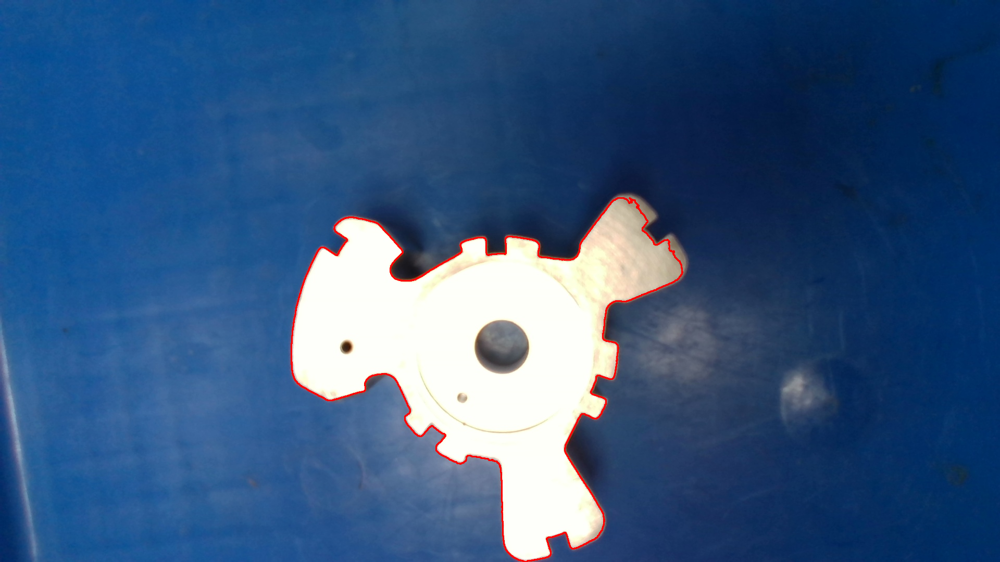

In [14]:
import cv2
from google.colab.patches import cv2_imshow
import numpy as np

# read the image
image = cv2.imread('/content/test/screenshot_2024-05-02_17-23-09.jpg')

# convert the image to grayscale format
img_gray = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)

# apply binary thresholding
ret, thresh = cv2.threshold(img_gray, 145, 255, cv2.THRESH_BINARY)

#tunable second parameter

# detect the contours on the binary image using cv2.CHAIN_APPROX_NONE
contours, hierarchy = cv2.findContours(image=thresh, mode=cv2.RETR_TREE, method=cv2.CHAIN_APPROX_NONE)

min_contour_area = 100000

# List to store contours that pass the area threshold
filtered_contours = []

# Iterate over each contour and store contours that pass the area threshold
for contour in contours:
    contour_area = cv2.contourArea(contour)
    if contour_area > min_contour_area:
        filtered_contours.append(contour)


contour_image = image.copy()
cv2.drawContours(contour_image, filtered_contours, contourIdx=0, color=(0, 0, 255), thickness=2)

cv2_imshow(contour_image)
cv2.waitKey(0)
cv2.destroyAllWindows()

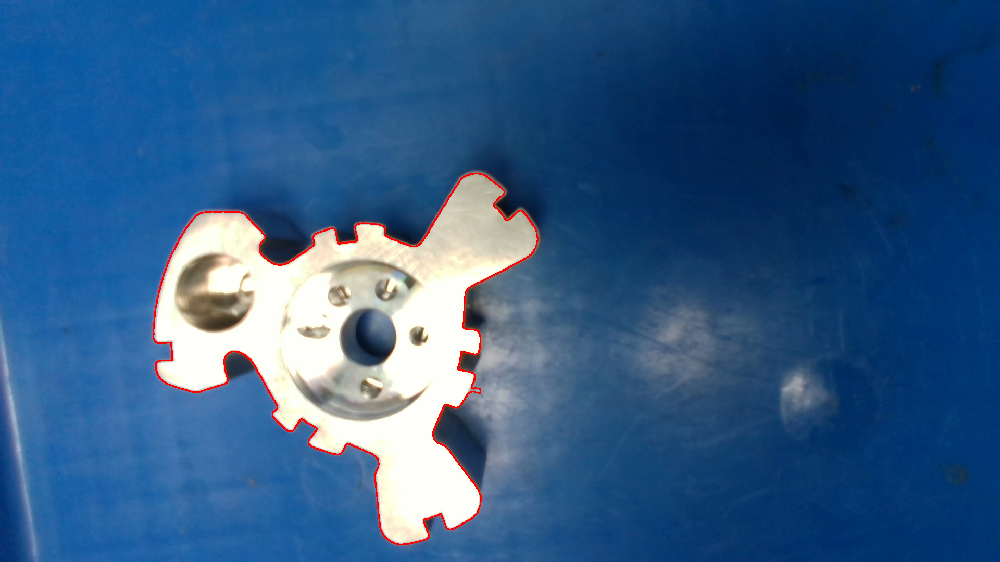

In [16]:
import cv2
from google.colab.patches import cv2_imshow
import numpy as np

# read the image
image = cv2.imread('/content/test/screenshot_2024-05-02_17-23-39.jpg')

# convert the image to grayscale format
img_gray = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)

# apply binary thresholding
ret, thresh = cv2.threshold(img_gray, 150, 255, cv2.THRESH_BINARY)

#tunable second parameter

# detect the contours on the binary image using cv2.CHAIN_APPROX_NONE
contours, hierarchy = cv2.findContours(image=thresh, mode=cv2.RETR_TREE, method=cv2.CHAIN_APPROX_NONE)

min_contour_area = 100000

# List to store contours that pass the area threshold
filtered_contours = []

# Iterate over each contour and store contours that pass the area threshold
for contour in contours:
    contour_area = cv2.contourArea(contour)
    if contour_area > min_contour_area:
        filtered_contours.append(contour)


contour_image = image.copy()
cv2.drawContours(contour_image, filtered_contours, contourIdx=0, color=(0, 0, 255), thickness=2)

cv2_imshow(contour_image)
cv2.waitKey(0)
cv2.destroyAllWindows()




The contour is strongly dependent on the tuning and the distinction between the background and the object , in the case where bg was blue the contours were close enough.